<a href="https://colab.research.google.com/github/mark-nick-o/camera_object_detection/blob/main/goose_pytorch1_7_detectron2_object_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Welcome to Google Colab

Colab is essentially Google's way of hosting a [jupyter notebook](https://jupyter.org/). A very popular tool to use as a data scientist!

It allows us to write code, documentation, and output visuals all in one place.

To be able to and edit the code in this workshop. Please make a copy for yourself

`file > save a copy in drive`

This should open a new tab with your own copy of this notebook. It can take a minute to load.

Colab comes with a lot of great data science libraries pre-installed. We'll show to start working with them in part-2 

Colab also gives you some options for running complicated computations such as training deep learning model. To see access those options:

`Runtime > change runtime type` Select `GPU`, `TPU`, or `None`

We don't need to change anything for this workshop, but its a great resource if you start learning deep learning and don't have a powerful GPU at home. 

This is a text cell. 

You can add a new text cell by clicking `+ Text` above. 

It does not highlight wrong spelling. I apologize for any typos!


### Code Cells

Below is a code cell. There is nothing in it right now.

To run a code cell click on it and then click the play button. Or press `shift+enter`

You can add new code cells by clicking the ` + Code ` button above



In [2]:
print("Hello world!")

Hello world!


### Run Terminal Commands

Colab actually gives you access to a whole ubuntu instance!

You can run terminal commands by putting `!` before the command

In [3]:
!ls

'=2.0.1'   sample_data


# Install Detectron2 and Dependencies

In [4]:
# Install torch 1.7 for detectron2 ( if colab  changes versions)

!pip install torch==1.7.0+cu101 torchvision==0.8.1+cu101 -f https://download.pytorch.org/whl/torch_stable.html

Looking in links: https://download.pytorch.org/whl/torch_stable.html


In [5]:
# install dependencies: 
!pip install pyyaml==5.1 pycocotools>=2.0.1
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

1.7.0+cu101 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [6]:
torch.__version__

'1.7.0+cu101'

In [7]:
torchvision.__version__

'0.8.1+cu101'

In [8]:
# # install detectron2: (Colab has CUDA 10.1 + torch 1.7)
# # See https://detectron2.readthedocs.io/tutorials/install.html for instructions
assert torch.__version__.startswith("1.7")
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html


In [9]:
# Make sure compatible pillow version
!pip install pillow==7.2
# %reload_ext autoreload
# %autoreload

     |████████████████████████████████| 2.2MB 9.0MB/s 
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: Pillow 8.0.1
    Uninstalling Pillow-8.0.1:
      Successfully uninstalled Pillow-8.0.1


In [1]:
# Some basic setup:
# Import detectron2 & common detectron2 utilities
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

import tqdm
import time

** fvcore version of PathManager will be deprecated soon. **
** Please migrate to the version in iopath repo. **
https://github.com/facebookresearch/iopath 

** fvcore version of PathManager will be deprecated soon. **
** Please migrate to the version in iopath repo. **
https://github.com/facebookresearch/iopath 



# Creating a Dataset

[Sign Up](https://sixgill.tech/sense-data-annotation) for Sense Data Annotation and use Promocode `WEBINAR90DAY` 90 days free. No card required.

Labeled with [Sense Data Annotation](https://sixgill.com/platform/sense-data-annotation/) and exported in the COCO format.

Read Sense Data Annotation docs [here](https://docs.sixgill.com/).

Give me any feedback / ask questions on [slack](https://sixgill.tech/slack)

![Labeling for object detection](https://gblobscdn.gitbook.com/assets%2F-MJxxV6sKASlEjxiEwc2%2F-MKrhpy2wLI2lxD79AhV%2F-MKrinYxj-fQSlHaP6jB%2FSmartPoly_2cows.gif?alt=media&token=667d94a8-2493-4e5c-846c-0bae50480ba4)




# Download our already labeled Dataset

For this project we're going to use my "famous" synthetic goose dataset. Read more about how and why that was created here: https://github.com/sagecodes/make-a-wildlife-object-detector

In [2]:
# download dataset from github
!!git clone https://github.com/mark-nick-o/camera_object_detection.git


["Cloning into 'camera_object_detection'...",
 'remote: Enumerating objects: 3, done.\x1b[K',
 'remote: Counting objects:  33% (1/3)\x1b[K',
 'remote: Counting objects:  66% (2/3)\x1b[K',
 'remote: Counting objects: 100% (3/3)\x1b[K',
 'remote: Counting objects: 100% (3/3), done.\x1b[K',
 'remote: Compressing objects:  33% (1/3)\x1b[K',
 'remote: Compressing objects:  66% (2/3)\x1b[K',
 'remote: Compressing objects: 100% (3/3)\x1b[K',
 'remote: Compressing objects: 100% (3/3), done.\x1b[K',
 'Receiving objects:   0% (1/1798)   ',
 'Receiving objects:   1% (18/1798)   ',
 'Receiving objects:   2% (36/1798)   ',
 'Receiving objects:   3% (54/1798)   ',
 'Receiving objects:   4% (72/1798)   ',
 'Receiving objects:   5% (90/1798)   ',
 'Receiving objects:   6% (108/1798)   ',
 'Receiving objects:   7% (126/1798)   ',
 'Receiving objects:   8% (144/1798)   ',
 'Receiving objects:   9% (162/1798)   ',
 'Receiving objects:  10% (180/1798)   ',
 'Receiving objects:  11% (198/1798)   ',
 'Recei

In [3]:
!ls camera_object_detection/

cow  img  README.md  script  test.json	train.json  validation.json


In [ ]:
!ls geese-object-detection-dataset/img

## Import a Dataset

### Setup COCO dataset for detectron2

[Detectron2 dataset docs](https://detectron2.readthedocs.io/tutorials/datasets.html)

[COCO](https://cocodataset.org/#home) is a popular dataset and computer vision dataset format




For this workshop we're using git clone, but for your own data you can use a couple other ways

- directly upload to colab instance
- mount to google drive <-- strongly encouraged for long term projects 


<-- You can easily to do both from the side bar

In [4]:
# import COCO format datasets
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/content/camera_object_detection/train.json", "/content/camera_object_detection")
register_coco_instances("my_dataset_val", {}, "/content/camera_object_detection/validation.json", "/content/camera_object_detection")

# bonus labled dataset for getting more metrics on our model
register_coco_instances("my_dataset_test", {}, "/content/camera_object_detection/test.json", "/content/camera_object_detection")


[12/30 10:07:18 d2.data.datasets.coco]: Loaded 1310 images in COCO format from /content/camera_object_detection/train.json


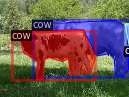

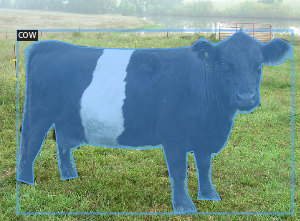

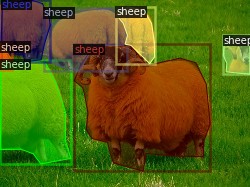

In [5]:
# check dataset is reading correctly
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")

dataset_dicts = DatasetCatalog.get("my_dataset_train")

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

# set meta data for validation set (we'll usue this later for testing)
test_metadata = MetadataCatalog.get("my_dataset_test")

You can learn more about this dataset [here](https://github.com/sagecodes/make-a-wildlife-object-detector)

In [6]:
dataset_dicts

[{'annotations': [{'bbox': [217.4250456291372,
     252.79328558300483,
     100.82497480181965,
     94.37763478658036],
    'bbox_mode': <BoxMode.XYWH_ABS: 1>,
    'category_id': 0,
    'iscrowd': 0,
    'segmentation': [[229.23337601133233,
      252.79328558300483,
      310.98335558037536,
      267.3129217040172,
      318.25002043095685,
      278.2026487947764,
      304.6250238361164,
      287.2774213704092,
      295.5416927728894,
      319.0391253851237,
      289.18336102863054,
      347.1709203695852,
      263.75003405159487,
      346.26344311202195,
      234.68337464926853,
      344.44848859689534,
      217.4250456291372,
      316.3166936124339,
      221.96671116075072,
      282.7400350825928,
      229.23337601133233,
      252.79328558300483]]},
   {'bbox': [384.55833719251393,
     321.7615571578135,
     138.06663216105042,
     69.87574883237203],
    'bbox_mode': <BoxMode.XYWH_ABS: 1>,
    'category_id': 0,
    'iscrowd': 0,
    'segmentation': [[405.4499

# Training a Detectron2 Model for Object Detection 

https://detectron2.readthedocs.io/tutorials/configs.html

model zoo: https://github.com/facebookresearch/Detectron/blob/master/MODEL_ZOO.md

Instance Segmentation: `COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml`

The warning: `Skip loading parameter 'roi_heads.box_predictor.cls_score.weight to the model due to incompatible shapes` is OK. It's because we have different number of classes than what the weights were trained on (81 clasess)

Optional: https://medium.com/@apofeniaco/training-on-detectron2-with-a-validation-set-and-plot-loss-on-it-to-avoid-overfitting-6449418fbf4e

In [7]:
# If you don't want to run validation you you can skip this cell
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class MyTrainer(DefaultTrainer):
    @classmethod
    def build_evaluator(cls, cfg, dataset_name, output_folder=None):
        if output_folder is None:
            output_folder = os.path.join(cfg.OUTPUT_DIR,"inference")
        return COCOEvaluator(dataset_name, cfg, True, output_folder)

In [143]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg() # initialize configuration
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")) # Define model
cfg.DATASETS.TRAIN = ("my_dataset_train",) # <- don't forget comma at end

cfg.DATALOADER.NUM_WORKERS = 0 # Can adjust for processes loading
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")  # Let training initialize from model zoo (transfer learning!)
cfg.SOLVER.IMS_PER_BATCH = 2 # Image per batch per GPU
cfg.SOLVER.BASE_LR = 0.002  # 0.001 pick a learning rate
cfg.SOLVER.MAX_ITER = 900    # 300 iterations seems good enough for this toy dataset; you may need to train longer for a practical dataset
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 767   # faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 8  # How many classes are in your dataset

# Create output directory for training
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

# Set default trainer with no validation (only have one trainer)
# cfg.DATASETS.TEST = ()
# trainer = DefaultTrainer(cfg)

### Un/comment below to run custom trainer with coco validation ###
cfg.DATASETS.TEST = ("my_dataset_val",) # you can implement a validation loader
cfg.TEST.EVAL_PERIOD = 50
trainer = MyTrainer(cfg)


trainer.resume_or_load(resume=False)
trainer.train()

[12/30 14:41:18 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (9, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (9,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (32, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (32,) in the model! You might want to double check if this is expected.


[12/30 14:41:19 d2.engine.train_loop]: Starting training from iteration 0
[12/30 14:41:49 d2.utils.events]:  eta: 0:21:58  iter: 19  total_loss: 2.564  loss_cls: 2.062  loss_box_reg: 0.4293  loss_rpn_cls: 0.03835  loss_rpn_loc: 0.04733  time: 1.5167  data_time: 0.0597  lr: 3.9962e-05  max_mem: 7689M
[12/30 14:42:23 d2.utils.events]:  eta: 0:22:50  iter: 39  total_loss: 1.641  loss_cls: 1.271  loss_box_reg: 0.3652  loss_rpn_cls: 0.04386  loss_rpn_loc: 0.03296  time: 1.6149  data_time: 0.0737  lr: 7.9922e-05  max_mem: 7891M
[12/30 14:42:39 d2.data.datasets.coco]: Loaded 164 images in COCO format from /content/camera_object_detection/validation.json
[12/30 14:42:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[12/30 14:42:39 d2.data.common]: Serializing 164 elements to byte tensors and concatenating them all ...
[12/30 14:42:39 d2.data.common]: Serialized dataset takes 0.3

/usr/local/lib/python3.6/dist-packages/PIL/Image.py:961: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[12/30 14:57:41 d2.utils.events]:  eta: 0:13:46  iter: 379  total_loss: 0.5362  loss_cls: 0.2359  loss_box_reg: 0.2367  loss_rpn_cls: 0.03049  loss_rpn_loc: 0.02621  time: 1.5652  data_time: 0.1224  lr: 0.00075924  max_mem: 8304M
[12/30 14:58:12 d2.data.datasets.coco]: Loaded 164 images in COCO format from /content/camera_object_detection/validation.json
[12/30 14:58:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[12/30 14:58:12 d2.data.common]: Serializing 164 elements to byte tensors and concatenating them all ...
[12/30 14:58:12 d2.data.common]: Serialized dataset takes 0.36 MiB
WARNING [12/30 14:58:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[12/30 14:58:12 d2.evaluation.evaluator]: Start inference on 164 images
[12/30 14:58:15 d2.evaluation.evaluator]: Inference done 11/164

In [144]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 601), started 4:32:18 ago. (Use '!kill 601' to kill it.)

<IPython.core.display.Javascript object>

# Use a Trained Model

In [ ]:
!ls ./output/

In [163]:
# Initialize config
cfg = get_cfg()
# Must be same as model trained in. Sense default: COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))
# Path to saved model weights (trained model)
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
# if using datasets for metadata
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 8
# Threshhold to show predictions lower value shows more distance ?
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.3
# create predictor instance to use
predictor = DefaultPredictor(cfg)

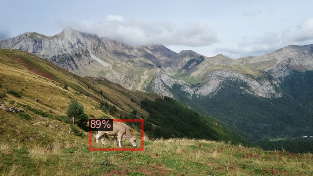

In [164]:
# Run test on an image
# from detectron2.utils.visualizer import ColorMode
test_image_path = '/content/camera_object_detection/cow/CW010.jpg'
im = cv2.imread(test_image_path)
outputs = predictor(im)
v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.5
    )
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

In [19]:
# What does an image look like to the computer?
print(im)

[[[185 115  48]
  [184 114  47]
  [187 113  49]
  ...
  [232 218 200]
  [231 218 202]
  [231 218 202]]

 [[183 112  48]
  [182 111  47]
  [183 111  47]
  ...
  [233 219 201]
  [232 219 203]
  [232 219 203]]

 [[176 107  44]
  [175 106  43]
  [179 108  45]
  ...
  [233 221 203]
  [233 220 204]
  [233 220 204]]

 ...

 [[  9 172 116]
  [  0 114  57]
  [ 18 188 130]
  ...
  [  0 124  70]
  [  0 115  65]
  [  0 105  55]]

 [[  0 158  98]
  [  0 159 100]
  [ 30 190 132]
  ...
  [ 16 138  84]
  [  0 115  64]
  [  8 125  76]]

 [[  0 172 109]
  [  5 176 114]
  [ 20 173 117]
  ...
  [ 35 155 101]
  [ 12 130  81]
  [ 15 133  84]]]


In [20]:
#What does the model output look like not drawn on an image?
print(outputs["instances"].to("cpu"))

Instances(num_instances=6, image_height=416, image_width=626, fields=[pred_boxes: Boxes(tensor([[427.1526, 199.6325, 555.7286, 280.3543],
        [253.4876, 193.0572, 323.2242, 245.1826],
        [ 38.2821, 185.5745, 144.6648, 279.9723],
        [182.3717, 193.8884, 220.3238, 239.2707],
        [315.7781, 188.4293, 359.5054, 216.0293],
        [375.1716, 189.4763, 413.2830, 218.5034]])), scores: tensor([0.9655, 0.9544, 0.9541, 0.9495, 0.9415, 0.9326]), pred_classes: tensor([0, 0, 0, 0, 0, 0])])


In [165]:
# Count objects detected in an image
object_count = outputs["instances"].to("cpu")
print("Detected "+str(len(object_count))+" object")

Detected 1 object


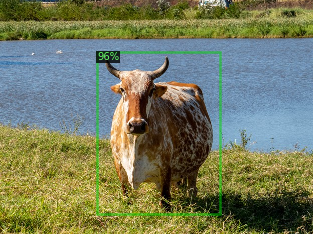

Detected 1 Objects in total


In [166]:
# Run test on an image
# from detectron2.utils.visualizer import ColorMode
test_image_path = '/content/camera_object_detection/cow/CW099.jpg'
im = cv2.imread(test_image_path)
outputs = predictor(im)
v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.5
    )
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])
object_count = outputs["instances"].to("cpu")
print("Detected "+str(len(object_count))+" Objects in total")

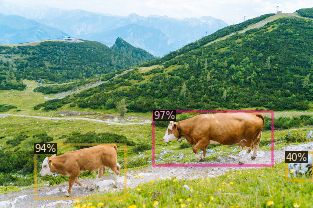

We have detected 3 Objects in total


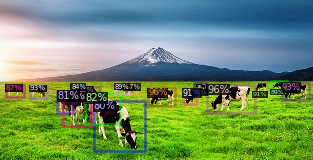

We have detected 17 Objects in total


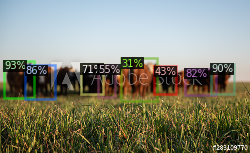

We have detected 8 Objects in total


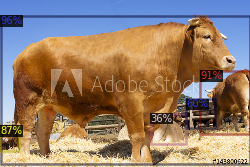

We have detected 5 Objects in total


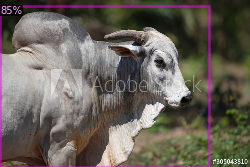

We have detected 1 Objects in total


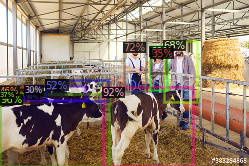

We have detected 11 Objects in total


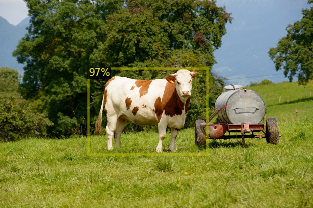

We have detected 1 Objects in total


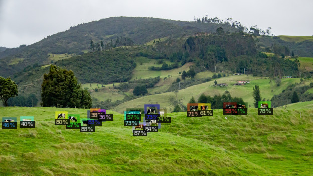

We have detected 19 Objects in total


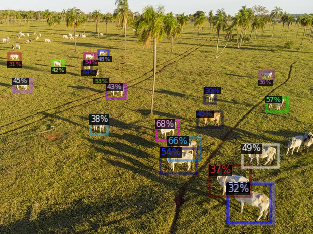

We have detected 20 Objects in total


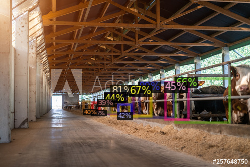

We have detected 11 Objects in total


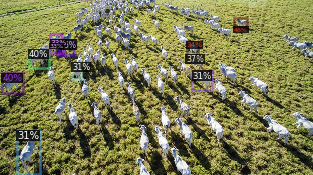

We have detected 11 Objects in total


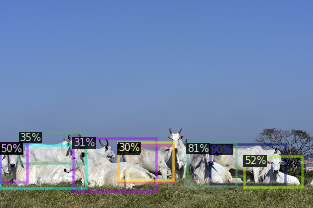

We have detected 9 Objects in total


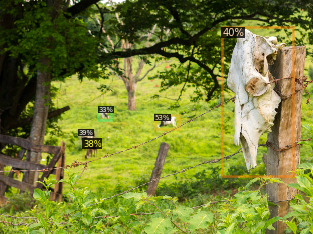

We have detected 5 Objects in total


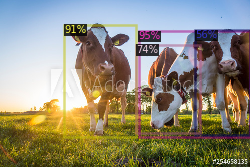

We have detected 4 Objects in total


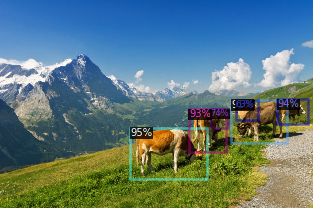

We have detected 6 Objects in total


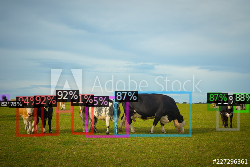

We have detected 11 Objects in total


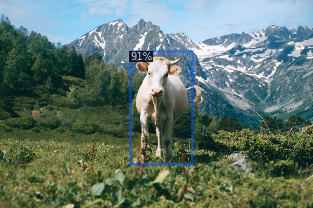

We have detected 1 Objects in total


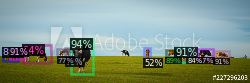

We have detected 12 Objects in total


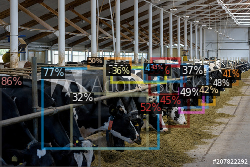

We have detected 16 Objects in total


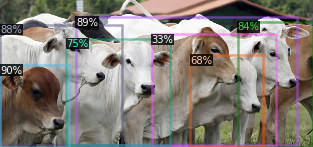

We have detected 7 Objects in total


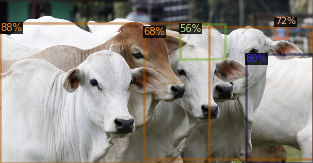

We have detected 5 Objects in total


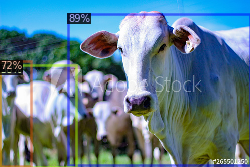

We have detected 3 Objects in total


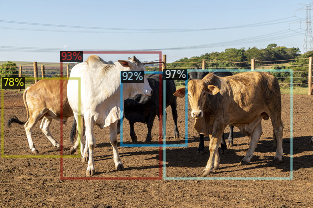

We have detected 4 Objects in total


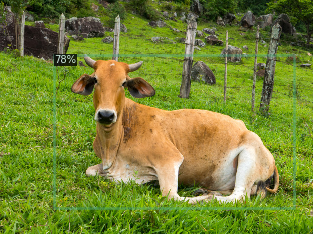

We have detected 1 Objects in total


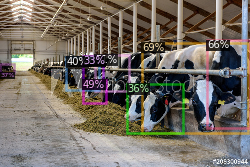

We have detected 8 Objects in total


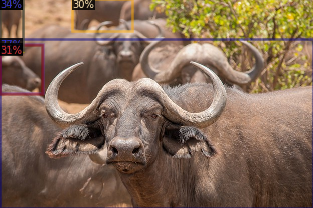

We have detected 6 Objects in total


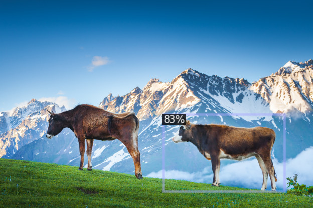

We have detected 1 Objects in total


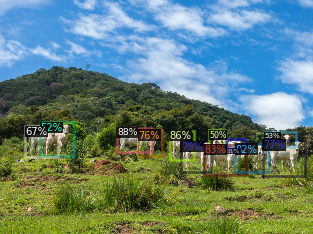

We have detected 12 Objects in total


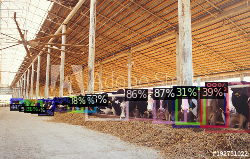

We have detected 16 Objects in total


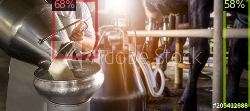

We have detected 2 Objects in total


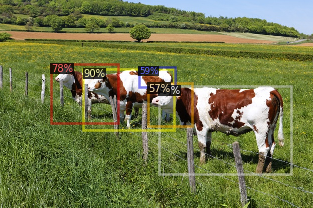

We have detected 5 Objects in total


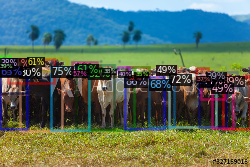

We have detected 25 Objects in total


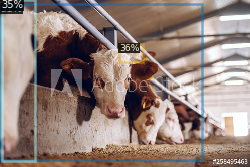

We have detected 3 Objects in total


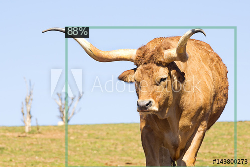

We have detected 1 Objects in total


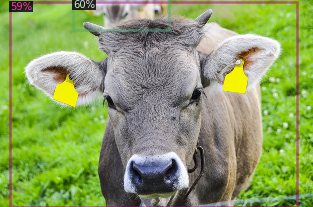

We have detected 2 Objects in total


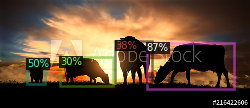

We have detected 4 Objects in total


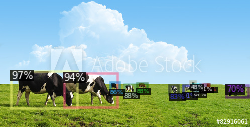

We have detected 14 Objects in total


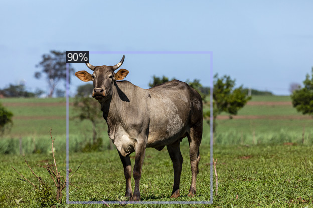

We have detected 1 Objects in total


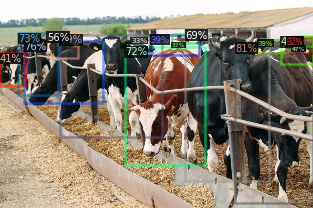

We have detected 15 Objects in total


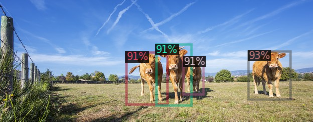

We have detected 4 Objects in total


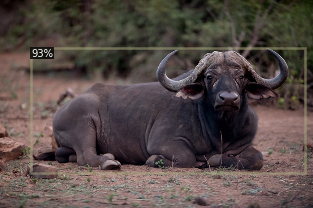

We have detected 1 Objects in total


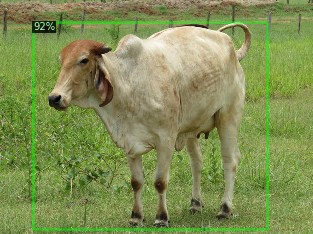

We have detected 1 Objects in total


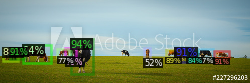

We have detected 12 Objects in total


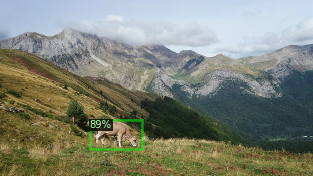

We have detected 1 Objects in total


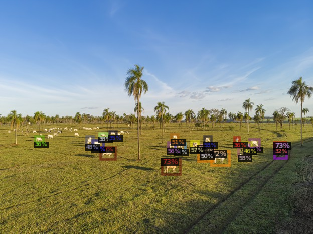

We have detected 21 Objects in total


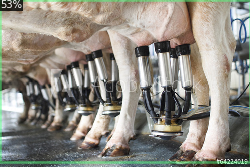

We have detected 1 Objects in total


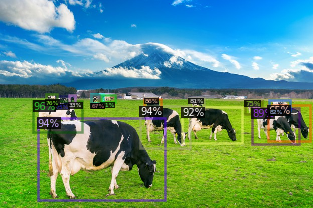

We have detected 16 Objects in total


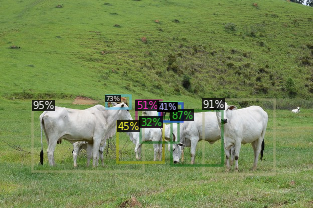

We have detected 9 Objects in total


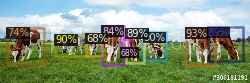

We have detected 9 Objects in total


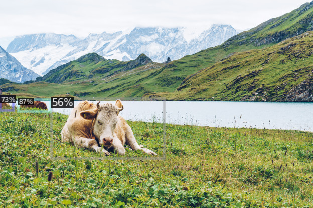

We have detected 3 Objects in total


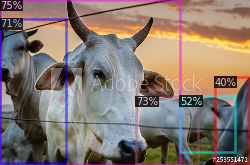

We have detected 5 Objects in total


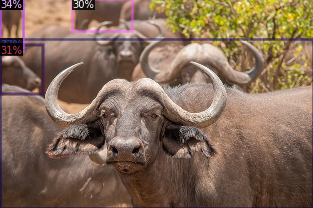

We have detected 6 Objects in total


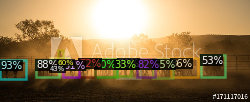

We have detected 13 Objects in total


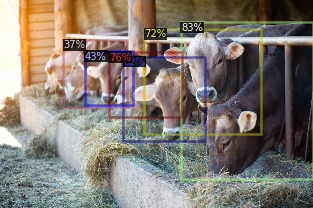

We have detected 6 Objects in total


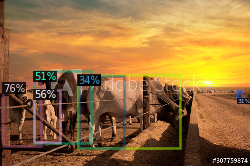

We have detected 6 Objects in total


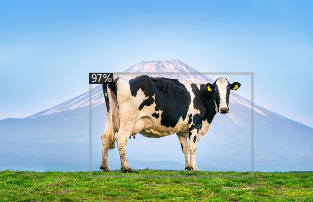

We have detected 1 Objects in total


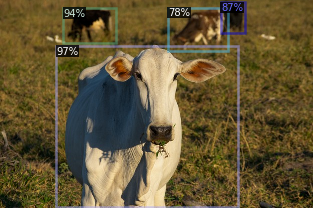

We have detected 4 Objects in total


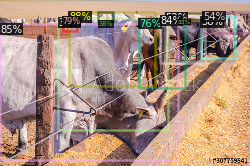

We have detected 11 Objects in total


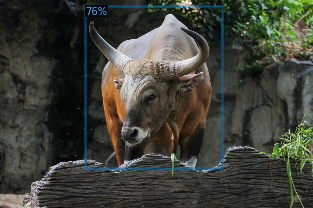

We have detected 1 Objects in total


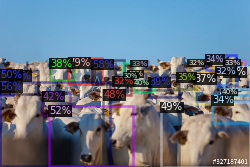

We have detected 25 Objects in total


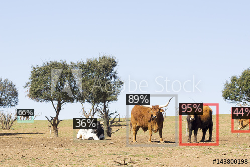

We have detected 5 Objects in total


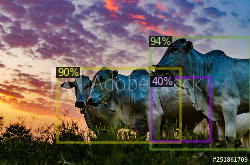

We have detected 3 Objects in total


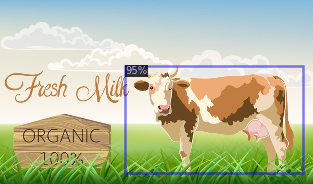

We have detected 1 Objects in total


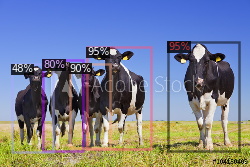

We have detected 5 Objects in total


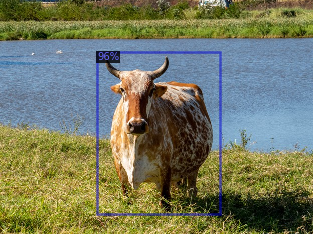

We have detected 1 Objects in total


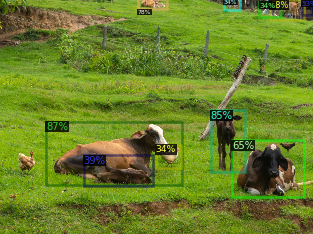

We have detected 10 Objects in total


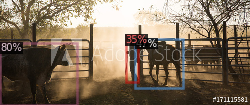

We have detected 3 Objects in total


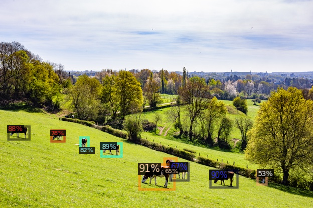

We have detected 9 Objects in total


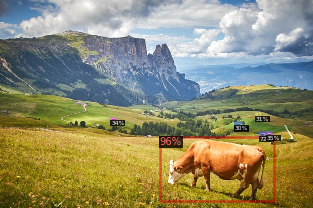

We have detected 7 Objects in total


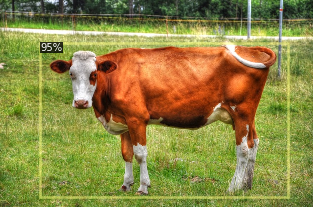

We have detected 1 Objects in total


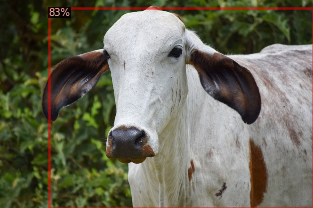

We have detected 1 Objects in total


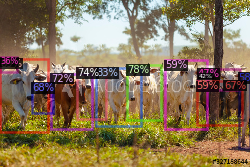

We have detected 13 Objects in total


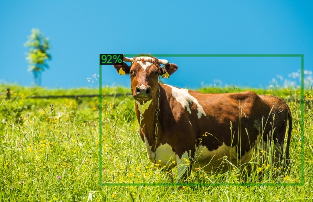

We have detected 1 Objects in total


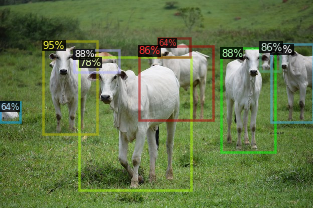

We have detected 9 Objects in total


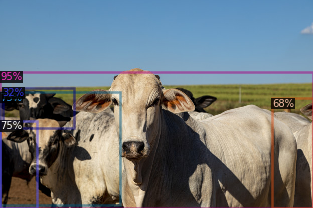

We have detected 5 Objects in total


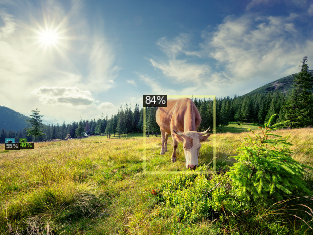

We have detected 3 Objects in total


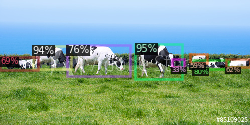

We have detected 8 Objects in total


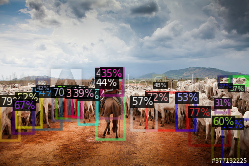

We have detected 24 Objects in total


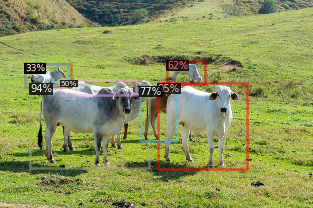

We have detected 7 Objects in total


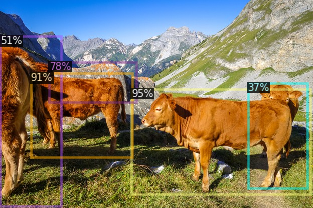

We have detected 5 Objects in total


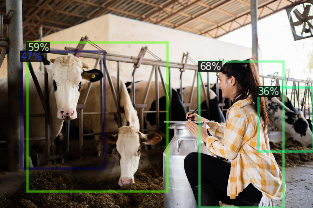

We have detected 4 Objects in total


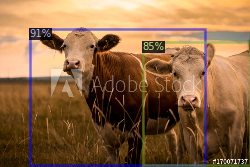

We have detected 2 Objects in total


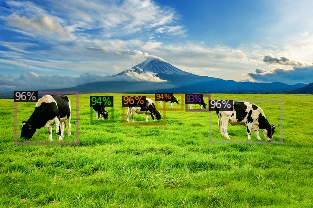

We have detected 6 Objects in total


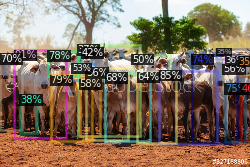

We have detected 21 Objects in total


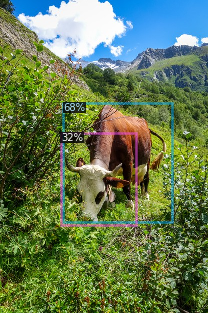

We have detected 2 Objects in total


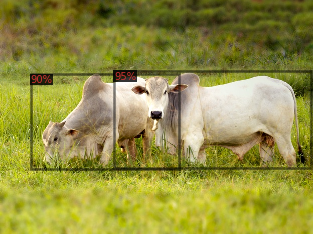

We have detected 2 Objects in total


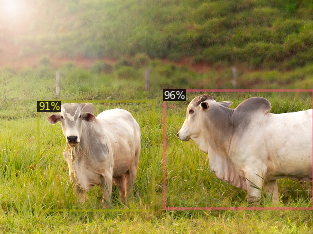

We have detected 2 Objects in total


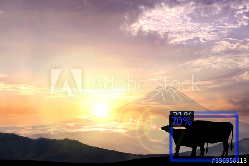

We have detected 2 Objects in total


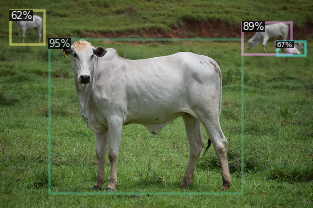

We have detected 4 Objects in total


In [167]:
# do this now for all the files in the objects directory 
directory = r'/content/camera_object_detection/cow'
for filename in os.listdir(directory):
    if filename.endswith(".jpg") or filename.endswith(".png"):
        test_image_path = os.path.join(directory, filename)
        im = cv2.imread(test_image_path)
        outputs = predictor(im)
        v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.5
            )
        out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
        cv2_imshow(out.get_image()[:, :, ::-1])
        object_count = outputs["instances"].to("cpu")
        print("We have detected "+str(len(object_count))+" Objects in total")
    else:
        continue

### Evaluation metrics

Here is great post that will go deeper into object detection evaluations metrics:

https://cocodataset.org/#detection-eval 

https://www.pyimagesearch.com/2018/05/14/a-gentle-guide-to-deep-learning-object-detection/

Detectron2 has built evaluation methods 

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
print(inference_on_dataset(trainer.model, val_loader, evaluator))

# Run detection on a video

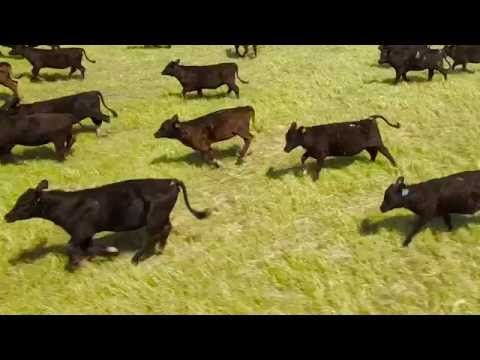

In [116]:
# This is the video we're going to process
from IPython.display import YouTubeVideo, display
video = YouTubeVideo("oCAZWVm-bpA", width=500)
display(video)

In [117]:
# Install dependencies, to download video, and crop for processing 
# Can skip if you are uploading your own video from google drive
!pip install youtube-dl
# !pip uninstall -y opencv-python-headless opencv-contrib-python
# !apt install python3-opencv  # the one pre-installed have some issues

     |████████████████████████████████| 1.9MB 7.8MB/s 


In [159]:
# Download video from youtube
if os.path.exists("video.mp4"):
  os.remove("video.mp4")
!youtube-dl https://www.youtube.com/watch?v=6ouXhsAEb5U -f 22 -o video.mp4

[youtube] 6ouXhsAEb5U: Downloading webpage
[download] Destination: video.mp4
[download] 100% of 121.28MiB in 00:02


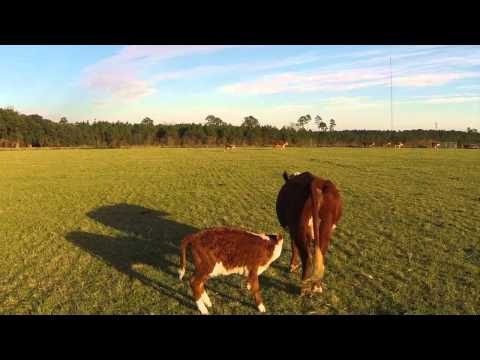

In [124]:
# This is another video we're going to process
from IPython.display import YouTubeVideo, display
video = YouTubeVideo("6ouXhsAEb5U", width=500)
display(video)

In [168]:


# Create clip from video. Useful for large videos (currently one minute long)
!ffmpeg -i /content/video.mp4 -t 00:03:00 -c:v copy video-clip.mp4

ffmpeg version 3.4.8-0ubuntu0.2 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-lib

In [169]:
from detectron2.utils.video_visualizer import VideoVisualizer
from detectron2.utils.visualizer import ColorMode, Visualizer

# Extract video properties
video = cv2.VideoCapture('video-clip.mp4')
width = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))
frames_per_second = video.get(cv2.CAP_PROP_FPS)
num_frames = int(video.get(cv2.CAP_PROP_FRAME_COUNT))
#num_frames=10000

# Initialize video writer
video_writer = cv2.VideoWriter('out.mp4', fourcc=cv2.VideoWriter_fourcc(*"mp4v"), fps=float(frames_per_second), frameSize=(width, height), isColor=True)

# Initialize visualizer
v = VideoVisualizer(MetadataCatalog.get(cfg.DATASETS.TEST[0]), ColorMode.IMAGE)

def runOnVideo(video, maxFrames):
    """ Runs the predictor on every frame in the video (unless maxFrames is given),
    and returns the frame with the predictions drawn.
    """

    readFrames = 0
    while True:
        hasFrame, frame = video.read()
        if not hasFrame:
            break

        # Get prediction results for this frame
        outputs = predictor(frame)

        # Make sure the frame is colored
        frame = cv2.cvtColor(frame, cv2.COLOR_RGB2BGR)

        # Draw a visualization of the predictions using the video visualizer
        visualization = v.draw_instance_predictions(frame, outputs["instances"].to("cpu"))

        # Convert Matplotlib RGB format to OpenCV BGR format
        visualization = cv2.cvtColor(visualization.get_image(), cv2.COLOR_RGB2BGR)

        yield visualization

        readFrames += 1
        if readFrames > maxFrames:
            break

# Enumerate the frames of the video
for visualization in tqdm.tqdm(runOnVideo(video, num_frames), total=num_frames):

    # Write to video file
    video_writer.write(visualization)

# Release resources
video.release()
video_writer.release()
cv2.destroyAllWindows()

100%|█████████▉| 5395/5396 [37:31<00:00,  2.40it/s]


In [170]:
# Download the results
from google.colab import files
files.download('out.mp4')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Keep Learning!

We just scratched the surface of the computer vision field, but I hope you feel confidant and inspired to learn more about it and creat your own projects! 

[Sign up for Sense Data Annotation](https://sixgill.tech/sense-data-annotation) & Start Labeling your own datasets! Retrain this notebook with them.

[Join me in slack](https://bit.ly/30lO9Cq) to ask any questions.

Follow Sixgill on [Medium](https://medium.com/sixgill) for Computer Vision Tutorials

Subscribe on [youtube](https://www.youtube.com/channel/UCWt--5NcY-O9PhjfPSDotew) for more content around computer vision.

Read/watch [my talk](https://github.com/sagecodes/make-a-wildlife-object-detector) on how to think about data and create sythetic data to improve your models.


### Learn more about different object detection methods:


- Single Shot MultiBox Detector (SSD) [explained](https://towardsdatascience.com/understanding-ssd-multibox-real-time-object-detection-in-deep-learning-495ef744fab) | [paper](https://arxiv.org/abs/1512.02325)

- You Only Look Once (YOLO) [Explained](https://medium.com/@jonathan_hui/real-time-object-detection-with-yolo-yolov2-28b1b93e2088) | [Paper](https://arxiv.org/abs/1506.02640) 

- Mask R-CNN [Explained](https://medium.com/@jonathan_hui/image-segmentation-with-mask-r-cnn-ebe6d793272) | [Paper](https://arxiv.org/abs/1703.06870)

- Detectron2 [github](https://github.com/facebookresearch/detectron2) | [official coloab](https://colab.research.google.com/drive/16jcaJoc6bCFAQ96jDe2HwtXj7BMD_-m5)

[Pyimagesearch](https://www.pyimagesearch.com/category/object-detection/) and [Machine Learning Mastery](https://machinelearningmastery.com/) are a great resources to take a look at. 


-------------------

#### Raw Links for chat:
https://sixgill.tech/sense-data-annotation

https://www.linkedin.com/in/sageelliott/

https://twitter.com/sagecodes

https://github.com/sagecodes

https://medium.com/sixgill

https://github.com/sagecodes/make-a-wildlife-object-detector

https://sixgill.tech/slack


